Please upload an image file (e.g., jpg, png):


Saving rgb_dog.jpg to rgb_dog.jpg
Output saved as averaged_3x3.jpg


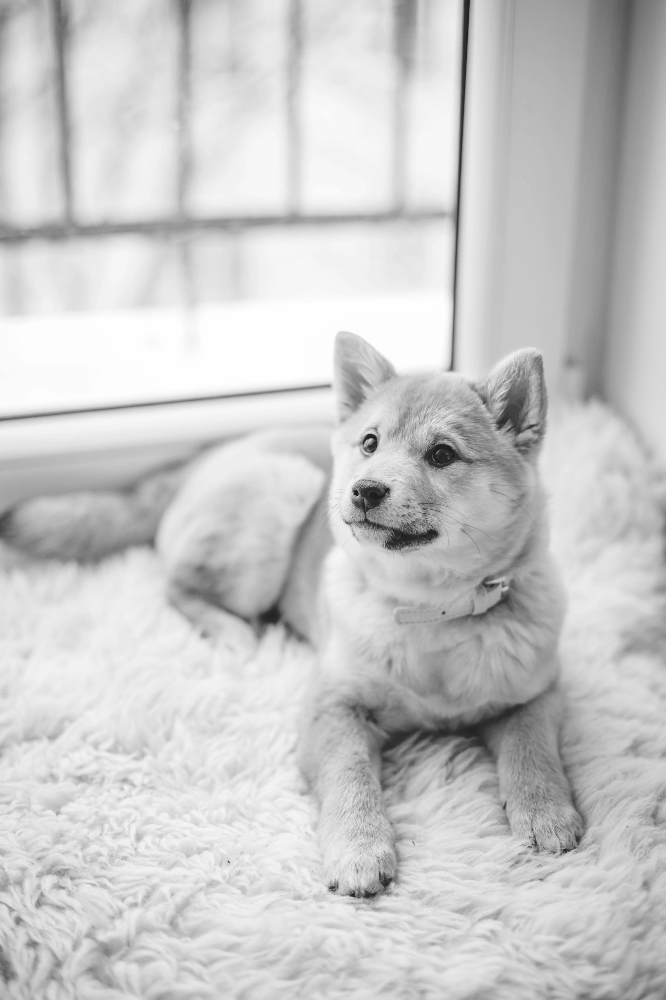

Output saved as averaged_10x10.jpg


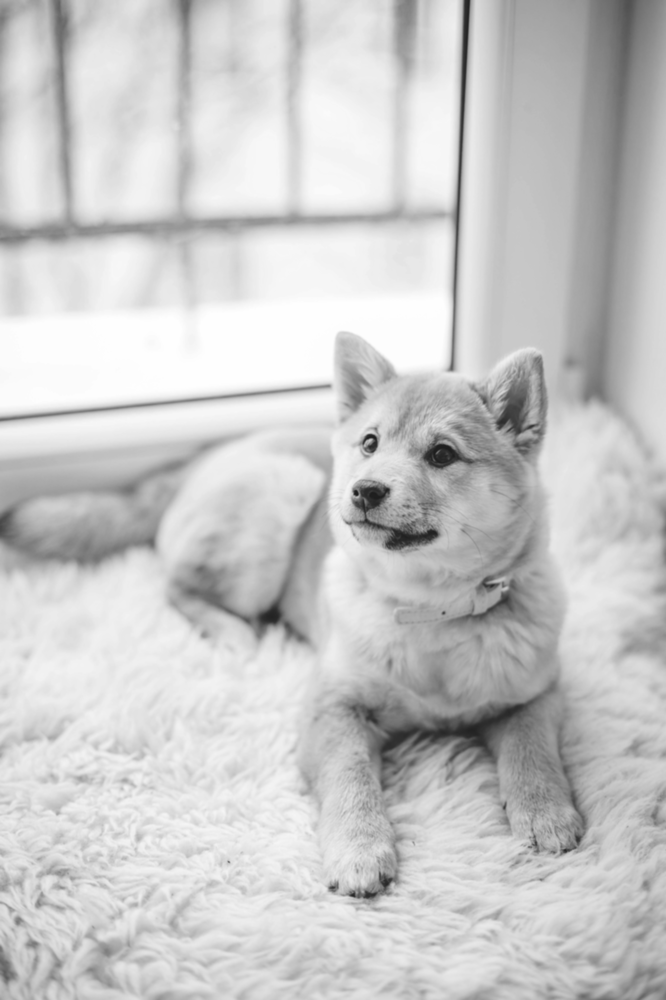

Output saved as averaged_20x20.jpg


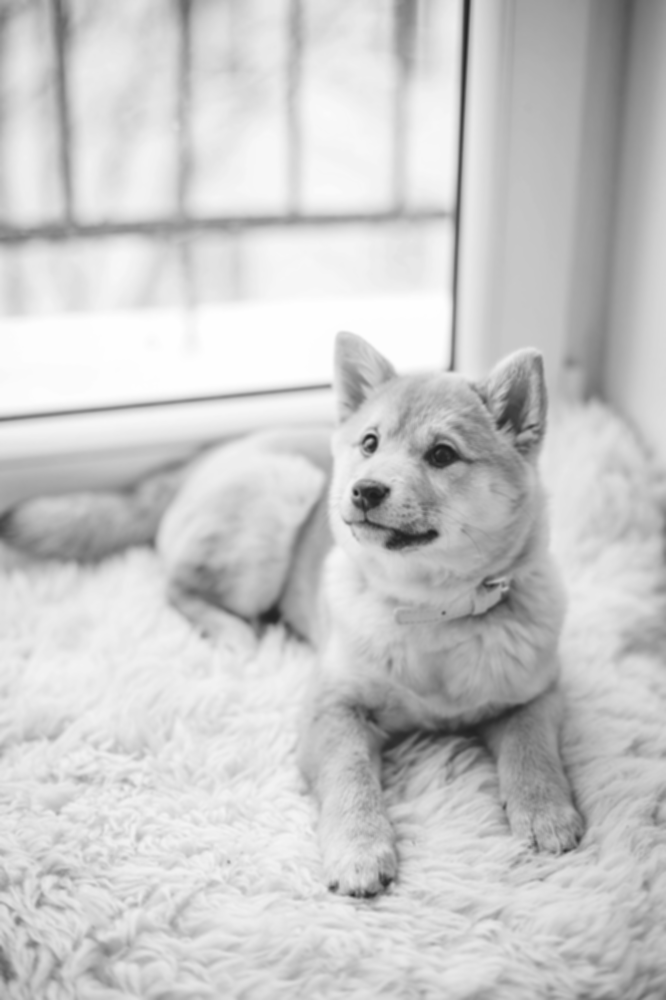

In [2]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from google.colab import files
import io

def apply_spatial_averaging(image, kernel_size):
    """
    Apply spatial averaging with a specified kernel size.
    """
    if len(image.shape) == 3:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Create averaging kernel
    kernel = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size * kernel_size)

    # Apply convolution
    averaged_image = cv2.filter2D(image, -1, kernel)
    return averaged_image

def main():
    # Prompt user to upload an image
    print("Please upload an image file (e.g., jpg, png):")
    uploaded = files.upload()

    # Check if an image was uploaded
    if not uploaded:
        raise FileNotFoundError("No image uploaded. Please upload an image file.")

    # Get the first uploaded file
    file_name = list(uploaded.keys())[0]
    image_data = uploaded[file_name]

    # Read the image from the uploaded data
    image = cv2.imdecode(np.frombuffer(image_data, np.uint8), cv2.IMREAD_GRAYSCALE)
    if image is None:
        raise FileNotFoundError("Failed to load the image. Ensure the file is a valid image format.")

    # Apply averaging for different kernel sizes
    kernel_sizes = [3, 10, 20]
    for size in kernel_sizes:
        result = apply_spatial_averaging(image, size)
        output_file = f'averaged_{size}x{size}.jpg'
        cv2.imwrite(output_file, result)
        print(f"Output saved as {output_file}")
        cv2_imshow(result)

if __name__ == "__main__":
    main()